<a href="https://colab.research.google.com/github/Prasoonjha1/Coronary_Heart_Diseases_Prediction/blob/main/HeartDiseases.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     | 22.0 MB 166 kB/s
     |████████████████████████████████| 102 kB 4.4 MB/s 
     |████████████████████████████████| 679 kB 34.5 MB/s 
     |████████████████████████████████| 62 kB 1.8 MB/s 
     |████████████████████████████████| 9.9 MB 62.7 MB/s 
     |████████████████████████████████| 4.7 MB 58.6 MB/s 
     |████████████████████████████████| 296 kB 57.6 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-dev-py2.py3-none-any.whl size=324949 sha256=b213185957e2aaac48fa0071900ccc093d97d1debf8dde42157cffb4675f6d1e
  Stored in directory: /tmp/pip-ephem-wheel-cache-dmg_ti11/wheels/64/b6/85/dfc808b23666a5910371784e349d28818006ff63ed9cfeca59
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=5229e4ace75d5e883442e3b0d0a13547c61528ff88cd908dc91e185399f74e65
  Stored in directory: /root/.cache/pip/wheels/23/14/6e/4be5bfeeb027f4939a01764b

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **1. Importing Libraries** 

In [ ]:
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import pandas_profiling as pp
from tensorflow.keras import regularizers
from keras.regularizers import l2,l1,L1L2
from keras.losses import binary_crossentropy
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
import random

# **2. Loading the data for pre-processing**

In [ ]:
data = pd.DataFrame(pd.read_csv('/content/drive/MyDrive/data/processed.cleveland.data'))
data1 = pd.DataFrame(pd.read_csv('/content/drive/MyDrive/data/statlog.csv'))





data1['num'] = np.where(data1['num']==1,0,1)

data['num'] = np.where(data['num']==0,0,1)
data = data.dropna(axis=0)
data2 = data
data = pd.concat([data,data1])
data = data.reset_index(drop=True)


In [ ]:
for i in data1:
  data1[i] = data1[i].apply(float)

**2.1 Seperating Categorical and Continous Data values.**

In [ ]:
categorical_val = []
continous_val = []
for column in data.columns:
    print("--------------------")
    print(f"{column} : {data[column].unique()}")
    if len(data[column].unique()) <= 10:
        categorical_val.append(column)
    else:
        continous_val.append(column)


--------------------
age : [63. 67. 37. 41. 56. 62. 57. 53. 44. 52. 48. 54. 49. 64. 58. 60. 50. 66.
 43. 40. 69. 59. 42. 55. 61. 65. 71. 51. 46. 45. 39. 68. 47. 34. 35. 29.
 70. 77. 38. 74. 76.]
--------------------
sex : [1. 0.]
--------------------
cp : [1. 4. 3. 2.]
--------------------
trestbps : [145. 160. 120. 130. 140. 172. 150. 110. 132. 117. 135. 112. 105. 124.
 125. 142. 128. 170. 155. 104. 180. 138. 108. 134. 122. 115. 118. 100.
 200.  94. 165. 102. 152. 101. 126. 174. 148. 178. 158. 192. 129. 144.
 123. 136. 146. 106. 156. 154. 114. 164.]
--------------------
chol : [233. 286. 229. 250. 204. 236. 268. 354. 254. 203. 192. 294. 256. 263.
 199. 168. 239. 275. 266. 211. 283. 284. 224. 206. 219. 340. 226. 247.
 167. 230. 335. 234. 177. 276. 353. 243. 225. 302. 212. 330. 175. 417.
 197. 198. 290. 253. 172. 273. 213. 305. 216. 304. 188. 282. 185. 232.
 326. 231. 269. 267. 248. 360. 258. 308. 245. 270. 208. 264. 321. 274.
 325. 235. 257. 164. 141. 252. 255. 201. 222. 260. 182. 303.

**2.2 Performing One-Hot Encoding on Categorical Data**

In [ ]:
categorical_val.remove('num')
dfs = pd.get_dummies(data, columns = categorical_val,drop_first=True)
dfs1 = pd.get_dummies(data1, columns = categorical_val,drop_first=True)
dfs2 = pd.get_dummies(data2, columns = categorical_val,drop_first=True)
dfs.head(6)

,age,trestbps,chol,thalach,oldpeak,num,sex_1.0,cp_2.0,cp_3.0,cp_4.0,...,restecg_1.0,restecg_2.0,exang_1.0,slope_2.0,slope_3.0,ca_1.0,ca_2.0,ca_3.0,thal_6.0,thal_7.0
0,63.0,145.0,233.0,150.0,2.3,0,1,0,0,0,...,0,1,0,0,1,0,0,0,1,0
1,67.0,160.0,286.0,108.0,1.5,1,1,0,0,1,...,0,1,1,1,0,0,0,1,0,0
2,67.0,120.0,229.0,129.0,2.6,1,1,0,0,1,...,0,1,1,1,0,0,1,0,0,1
3,37.0,130.0,250.0,187.0,3.5,0,1,0,1,0,...,0,0,0,0,1,0,0,0,0,0
4,41.0,130.0,204.0,172.0,1.4,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
5,56.0,120.0,236.0,178.0,0.8,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0


**2.3 Standardizing the continous data.**

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

dfs[continous_val] = sc.fit_transform(dfs[continous_val])
dfs1[continous_val] = sc.fit_transform(dfs1[continous_val])
dfs2[continous_val] = sc.fit_transform(dfs2[continous_val])
dfs.head(6)

,age,trestbps,chol,thalach,oldpeak,num,sex_1.0,cp_2.0,cp_3.0,cp_4.0,...,restecg_1.0,restecg_2.0,exang_1.0,slope_2.0,slope_3.0,ca_1.0,ca_2.0,ca_3.0,thal_6.0,thal_7.0
0,0.939036,0.757771,-0.298425,0.015791,1.080503,0,1,0,0,0,...,0,1,0,0,1,0,0,0,1,0
1,1.380431,1.601447,0.725316,-1.809669,0.387367,1,1,0,0,1,...,0,1,1,1,0,0,0,1,0,0
2,1.380431,-0.648356,-0.375689,-0.896939,1.340429,1,1,0,0,1,...,0,1,1,1,0,0,1,0,0,1
3,-1.930034,-0.085905,0.029945,1.623934,2.120206,0,1,0,1,0,...,0,0,0,0,1,0,0,0,0,0
4,-1.488639,-0.085905,-0.858585,0.971984,0.300725,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
5,0.166594,-0.648356,-0.240477,1.232764,-0.219126,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
X = dfs.drop('num', axis=1)
y = dfs.num


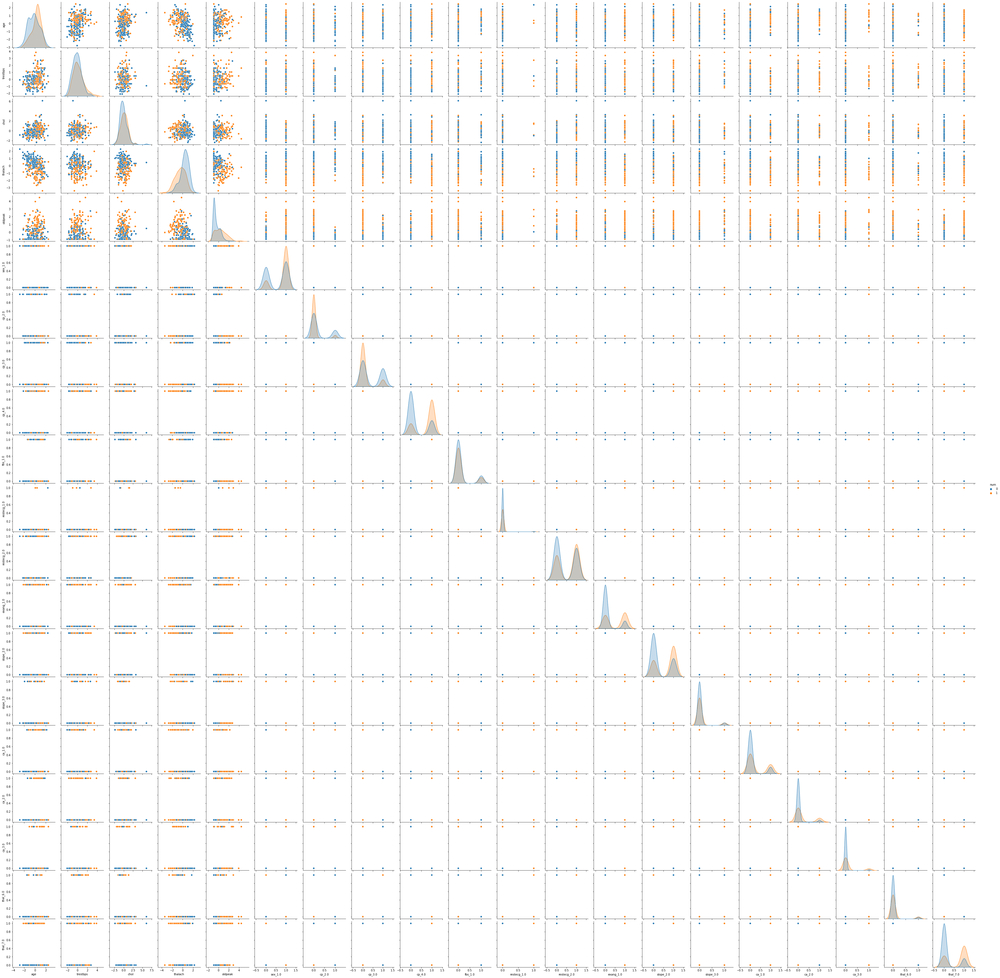

In [ ]:
import seaborn as sns
sns.pairplot(dfs, hue='num')

In [ ]:
profile = pp.ProfileReport(dfs, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**2.5 Data slicing for testing and training**

In [ ]:
!pip install pyswarms

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 104 kB 4.1 MB/s 


In [ ]:
from sklearn import linear_model
import pyswarms as ps

# Create an instance of the classifier
classifier = linear_model.LogisticRegression()

# Define objective function
def f_per_particle(m, alpha):
    """Computes for the objective function per particle

    Inputs
    ------
    m : numpy.ndarray
        Binary mask that can be obtained from BinaryPSO, will
        be used to mask features.
    alpha: float (default is 0.5)
        Constant weight for trading-off classifier performance
        and number of features

    Returns
    -------
    numpy.ndarray
        Computed objective function
    """
    total_features = X.shape[1]
    # Get the subset of the features from the binary mask
    if np.count_nonzero(m) == 0:
        X_subset = X.values
    else:
        X_subset = X.values[:,m==1]
    # Perform classification and store performance in P
    classifier.fit(X_subset, y)
    P = (classifier.predict(X_subset) == y.values).mean()
    # Compute for the objective function
    j = (alpha * (1.0 - P)
        + (1.0 - alpha) * (1 - (X_subset.shape[1] / total_features)))

    return j

In [ ]:
def f(x, alpha=0.91):
    """Higher-level method to do classification in the
    whole swarm.

    Inputs
    ------
    x: numpy.ndarray of shape (n_particles, dimensions)
        The swarm that will perform the search

    Returns
    -------
    numpy.ndarray of shape (n_particles, )
        The computed loss for each particle
    """
    n_particles = x.shape[0]
    j = [f_per_particle(x[i], alpha) for i in range(n_particles)]
    return np.array(j)

In [ ]:
# Initialize swarm, arbitrary
options = {'c1': 0.5, 'c2': 0.5, 'w':0.9, 'k': 50, 'p':2}

# Call instance of PSO
dimensions = X.shape[1] # dimensions should be the number of features
optimizer = ps.discrete.BinaryPSO(n_particles=50, dimensions=dimensions, options=options)
optimizer.reset()

# Perform optimization
cost, pos = optimizer.optimize(f, iters=200)

2022-12-13 05:24:23,214 - pyswarms.discrete.binary - INFO - Optimize for 200 iters with {'c1': 0.5, 'c2': 0.5, 'w': 0.9, 'k': 50, 'p': 2}
pyswarms.discrete.binary: 100%|██████████|200/200, best_cost=0.118
2022-12-13 05:26:29,265 - pyswarms.discrete.binary - INFO - Optimization finished | best cost: 0.11845061728395066, best pos: [1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [ ]:
dfs1.drop(dfs1.columns[[10]], axis=1, inplace=True)
dfs2.drop(dfs2.columns[[10]], axis=1, inplace=True)

In [ ]:
from sklearn.cluster import DBSCAN
dbscan1=DBSCAN()
dbscan2=DBSCAN()
dbscan1.fit(dfs1)
dbscan2.fit(dfs2)

DBSCAN()

In [ ]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=5)
nbrs = neigh.fit(dfs1)
distances, indices = nbrs.kneighbors(dfs1)

neigh1 = NearestNeighbors(n_neighbors=5)
nbrs1 = neigh.fit(dfs2)
distances1, indices1 = nbrs.kneighbors(dfs2)



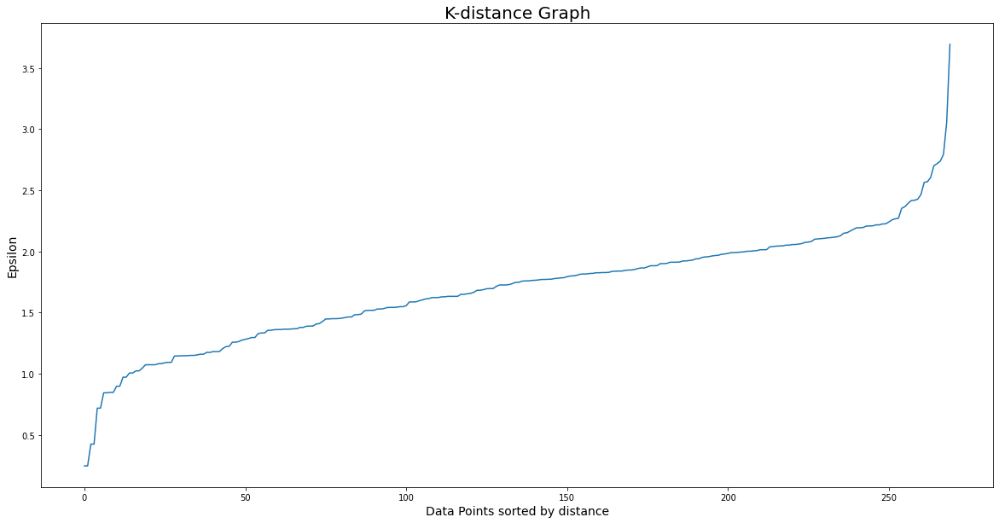

In [ ]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(20,10))
plt.plot(distances)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points sorted by distance',fontsize=14)
plt.ylabel('Epsilon',fontsize=14)
plt.show()

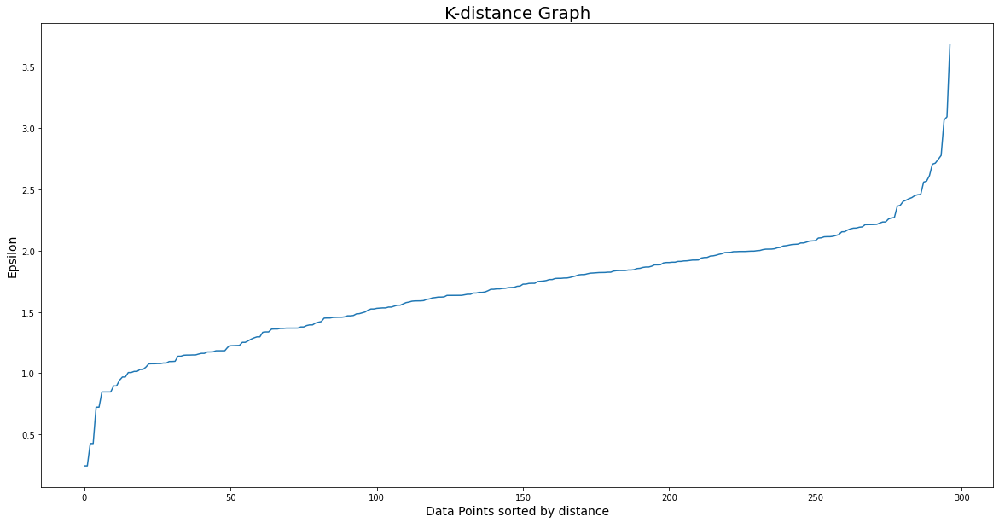

In [ ]:
distances1 = np.sort(distances1, axis=0)
distances1 = distances1[:,1]
plt.figure(figsize=(20,10))
plt.plot(distances1)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points sorted by distance',fontsize=14)
plt.ylabel('Epsilon',fontsize=14)
plt.show()

In [ ]:
model1 = DBSCAN(eps = 2.4,min_samples=5).fit(dfs1)
model2 = DBSCAN(eps = 2.5, min_samples=5).fit(dfs2)

In [ ]:
outliers = dfs1[model1.labels_ == -1].index
outliers1 = dfs2[model2.labels_ == -1].index

In [ ]:
print(outliers.size+outliers1.size)

27


In [ ]:
dfs1 = dfs1.drop(labels=outliers)
dfs2 = dfs2.drop(labels=outliers1)


In [ ]:
dfs = pd.concat([dfs1,dfs2],axis=0)
dfs = dfs.reset_index(drop=True)

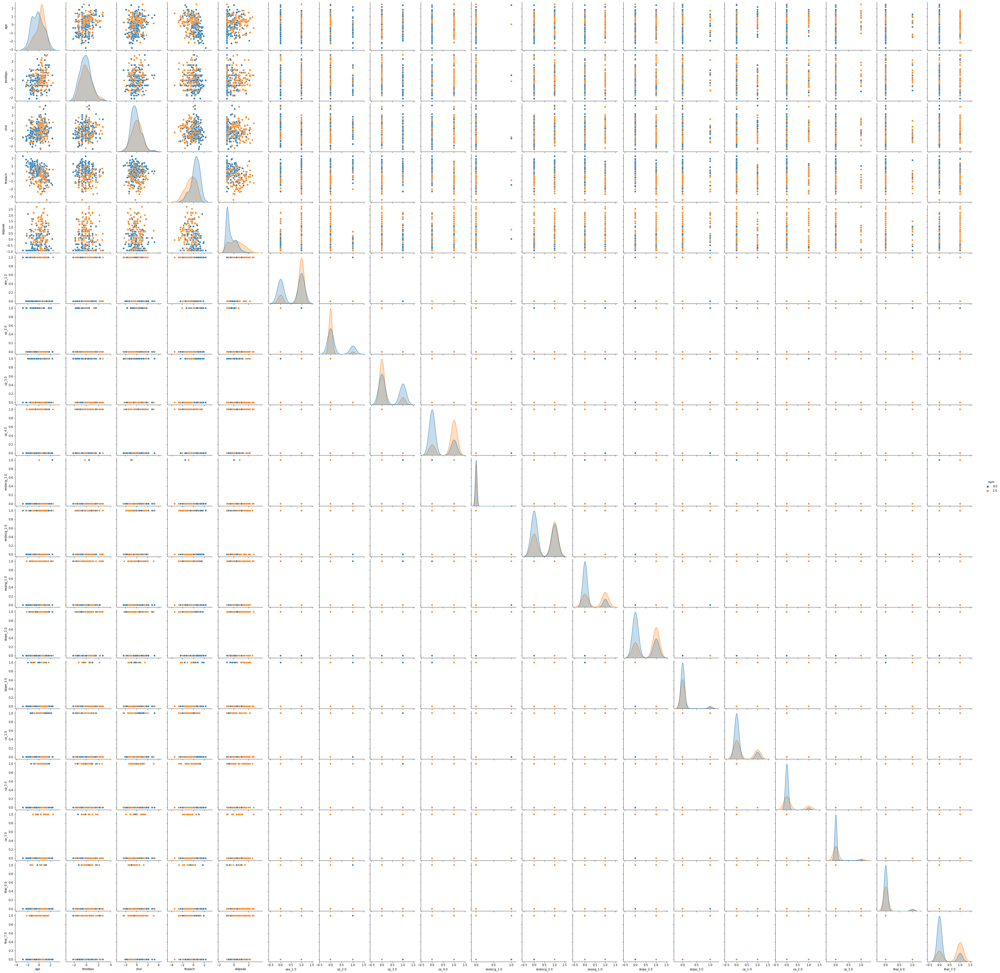

In [ ]:
import seaborn as sns
sns.pairplot(dfs, hue='num')

In [ ]:
profile = pp.ProfileReport(dfs, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
X = dfs.drop('num',axis=1)
y = dfs.num

# **3. Development of Neural Network Model and Training**

In [ ]:
# Load the TensorBoard notebook extension
import tensorboard
import datetime, os
%reload_ext tensorboard

**3.1 Creatig functions for metrics like f1-score.**

In [ ]:
import keras.backend as K

def f1_score(y_true, y_pred): #taken from old keras source code
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

def precision(y_true,y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def recall(y_true,y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall


**3.2 Created a Neural Netwwork Model Using Keras**

In [ ]:

def create_model(a,b,c):
  ann = tf.keras.models.Sequential()
  ann.add(tf.keras.layers.Dense(units=a, activation='relu',kernel_regularizer = regularizers.L1L2(c),bias_regularizer=L1L2(c)))
  ann.add(tf.keras.layers.Dense(units=b, activation='relu',kernel_regularizer = regularizers.L1L2(c),bias_regularizer=L1L2(c)))
  ann.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

  ann.compile(optimizer="Adam", loss=binary_crossentropy, metrics=['accuracy',f1_score,precision,recall])

  return ann


**3.3 Training of the Model**

In [ ]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import EditedNearestNeighbours
from sklearn.model_selection import train_test_split
result = []
def train_evaluate(model, X_train, y_train, X_test, y_test):
  log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
  '''sm = SMOTE(random_state = 42)
  X_train_res, y_train_res = sm.fit_resample(X_train,y_train)
  enn = EditedNearestNeighbours()
  X_train1, y_train1 = enn.fit_resample(X_train_res, y_train_res)'''
  model.fit(X_train,y_train,batch_size=32,epochs = 100,callbacks=[tensorboard_callback])
  if i==1:
    model.save('/content/drive/MyDrive/data/model.h5')
  model1 = keras.models.load_model('/content/drive/MyDrive/data/model.h5',custom_objects={"f1_score": f1_score,"precision":precision,"recall":recall})
  
  result1 = model1.evaluate(X_test,y_test)
  result2 = model.evaluate(X_test,y_test)
  if result2[1]>result1[1]:
    model.save('/content/drive/MyDrive/data/model.h5')
  result.append(model.evaluate(X_test,y_test))

from sklearn.model_selection import StratifiedKFold
kFold = StratifiedKFold(n_splits=5)
i = 0
for train, test in kFold.split(X, y):
      model = None
      i=i+1
      model = create_model(8,10,0.001)
      train_evaluate(model, X.loc[train], y.loc[train], X.loc[test], y.loc[test])


Epoch 1/100
14/14 [==============================] - 1s 7ms/step - loss: 0.7706 - accuracy: 0.3981 - f1_score: 0.2924 - precision: 0.3132 - recall: 0.2912
Epoch 2/100
14/14 [==============================] - 0s 4ms/step - loss: 0.7497 - accuracy: 0.5162 - f1_score: 0.3455 - precision: 0.4015 - recall: 0.3145
Epoch 3/100
14/14 [==============================] - 0s 4ms/step - loss: 0.7298 - accuracy: 0.5810 - f1_score: 0.3887 - precision: 0.5132 - recall: 0.3314
Epoch 4/100
14/14 [==============================] - 0s 4ms/step - loss: 0.7107 - accuracy: 0.6667 - f1_score: 0.4928 - precision: 0.7002 - recall: 0.4000
Epoch 5/100
14/14 [==============================] - 0s 5ms/step - loss: 0.6894 - accuracy: 0.7199 - f1_score: 0.6162 - precision: 0.7914 - recall: 0.5205
Epoch 6/100
14/14 [==============================] - 0s 4ms/step - loss: 0.6654 - accuracy: 0.7616 - f1_score: 0.6913 - precision: 0.7873 - recall: 0.6409
Epoch 7/100
14/14 [==============================] - 0s 5ms/step - los

In [ ]:
print("Loss               Accuracy         F1-Score             Precision             Recall        \n-----------------------------------------------------------------------------------------")
for i in result:
  print(str(i[0])+" "*(20-len(str(i[0])))+str(i[1])+" "*(20-len(str(i[1])))+str(i[2])+" "*(20-len(str(i[2])))+str(i[3])+" "*(20-len(str(i[3])))+str(i[4]))

Loss               Accuracy         F1-Score             Precision             Recall        
-----------------------------------------------------------------------------------------
0.3602738082408905  0.8518518805503845  0.8272791504859924  0.8740384578704834  0.802609920501709
0.27860116958618164 0.9074074029922485  0.9005081057548523  0.8752990365028381  0.9333332777023315
0.5228596925735474  0.8425925970077515  0.8056899309158325  0.8802884817123413  0.745039701461792
0.2789038121700287  0.9166666865348816  0.9013227224349976  0.8990384340286255  0.9151785373687744
0.43873804807662964 0.8240740895271301  0.7715873718261719  0.8708333373069763  0.6988095045089722


In [ ]:
acc = []
f1 = []
pre = []
re = []
lo = []
for i in result:
  lo.append(i[0])
  acc.append(i[1])
  f1.append(i[2])
  pre.append(i[3])
  re.append(i[4])

print("Loss               Accuracy         F1-Score             Precision             Recall        \n-----------------------------------------------------------------------------------------")
print(str(np.mean(lo))+" "*(20-len(str(np.mean(lo))))+str(np.mean(acc))+" "*(20-len(str(np.mean(acc))))+str(np.mean(f1))+" "*(20-len(str(np.mean(f1))))+str(np.mean(pre))+" "*(20-len(str(np.mean(pre))))+str(np.mean(re)))

Loss               Accuracy         F1-Score             Precision             Recall        
-----------------------------------------------------------------------------------------
0.3758753061294556  0.8685185313224792  0.8412774562835693  0.879899549484253   0.8189941883087158


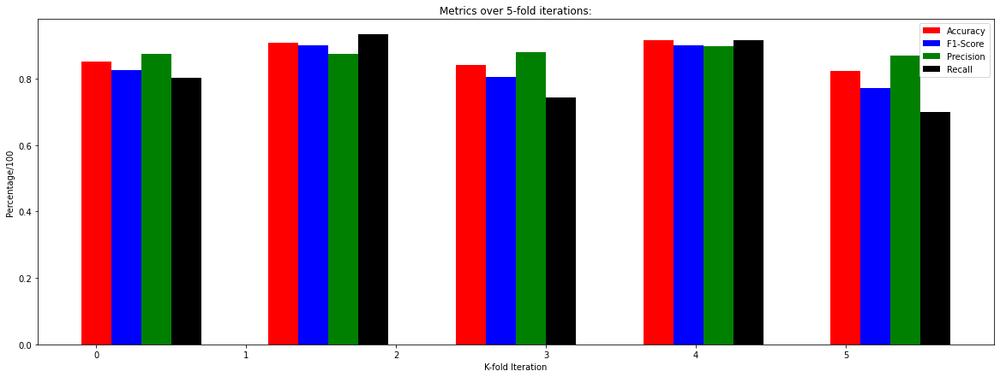

In [ ]:
pl = np.linspace(0,5,5)
plt.figure(figsize=(20,7))
plt.title('Metrics over 5-fold iterations:')
plt.xlabel('K-fold Iteration')
plt.ylabel('Percentage/100')
plt.bar(pl,acc,0.2,color='red',label='Accuracy')
plt.bar(pl+0.2,f1,0.2,color='blue',label='F1-Score')
plt.bar(pl+0.4,pre,0.2,color='green',label='Precision')
plt.bar(pl+0.6,re,0.2,color='black',label='Recall')
plt.legend()
plt.show()

# **4. Testing and evaluation of the Model**

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
model1 = keras.models.load_model('/content/drive/MyDrive/data/model.h5',custom_objects={"f1_score": f1_score,"precision":precision,"recall":recall})


In [ ]:
from sklearn.metrics import confusion_matrix,classification_report
import math
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.5,shuffle=True)
y_pred = model.predict(X_test)
print(classification_report(y_test,y_pred.round()))

9/9 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95       164
         1.0       0.92      0.92      0.92       106

    accuracy                           0.93       270
   macro avg       0.93      0.93      0.93       270
weighted avg       0.93      0.93      0.93       270



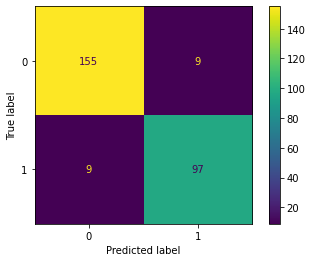

In [ ]:
cm = confusion_matrix(y_test,y_pred.round())
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

disp = ConfusionMatrixDisplay(confusion_matrix=np.asarray(cm), display_labels=np.asarray([0,1]))

disp.plot()
# NOTE: Fill all variables here with default values of the plot_confusion_matrix


plt.show()